In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
import torch
import torch.optim as optim
# import module we'll need to import our custom module
# from shutil import copyfile

# # copy our file into the working directory (make sure it has .py suffix)
# copyfile(src = "/kaggle/input/yolov3-config/config.py", dst = "../working/config.py")
# copyfile(src = "/kaggle/input/yolov3-config/dataset.py", dst = "../working/dataset.py")
# copyfile(src = "/kaggle/input/yolov3-config/dataset_org.py", dst = "../working/dataset_org.py")
# copyfile(src = "/kaggle/input/yolov3-config/loss.py", dst = "../working/loss.py")
# copyfile(src = "/kaggle/input/yolov3-config/model.py", dst = "../working/model.py")
# copyfile(src = "/kaggle/input/yolov3-config/train.py", dst = "../working/train.py")
# copyfile(src = "/kaggle/input/yolov3-config/utils.py", dst = "../working/utils.py")

In [3]:
import config
from model import YOLOv3
from tqdm import tqdm
from utils import (
    mean_average_precision,
    cells_to_bboxes,
    get_evaluation_bboxes,
    save_checkpoint,
    load_checkpoint,
    check_class_accuracy,
    get_loaders,
    plot_couple_examples
)
from loss import YoloLoss
import warnings
warnings.filterwarnings("ignore")

d:\Anaconda\envs\theschoolofai\lib\site-packages\torchaudio\backend\utils.py:74: UserWarning: No audio backend is available.
  warnings.warn("No audio backend is available.")


In [4]:
def train_fn(train_loader, model, optimizer, loss_fn, scaler, scaled_anchors, scheduler):
    loop = tqdm(train_loader, leave=True)
    losses = []
    for batch_idx, (x, y) in enumerate(loop):
        x = x.to(config.DEVICE)
        y0, y1, y2 = (
            y[0].to(config.DEVICE),
            y[1].to(config.DEVICE),
            y[2].to(config.DEVICE),
        )

        with torch.cuda.amp.autocast():
            out = model(x)
            loss = (
                loss_fn(out[0], y0, scaled_anchors[0])
                + loss_fn(out[1], y1, scaled_anchors[1])
                + loss_fn(out[2], y2, scaled_anchors[2])
            )

        losses.append(loss.item())
        optimizer.zero_grad()
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        scheduler.step()

        # update progress bar
        mean_loss = sum(losses) / len(losses)
        loop.set_postfix(loss=mean_loss)

In [5]:
model = YOLOv3(num_classes=config.NUM_CLASSES).to(config.DEVICE)
optimizer = optim.Adam(
    model.parameters(), lr=config.LEARNING_RATE, weight_decay=config.WEIGHT_DECAY
)
loss_fn = YoloLoss()
scaler = torch.cuda.amp.GradScaler()

train_loader, test_loader, train_eval_loader = get_loaders(
    train_csv_path=config.DATASET + "/train.csv", test_csv_path=config.DATASET + "/test.csv"
)

if config.LOAD_MODEL:
    load_checkpoint(
        config.CHECKPOINT_FILE, model, optimizer, config.LEARNING_RATE
    )


In [6]:
# !pip install torch_lr_finder

In [7]:
from torch_lr_finder import LRFinder
scaled_anchors = (
    torch.tensor(config.ANCHORS)
    * torch.tensor(config.S).unsqueeze(1).unsqueeze(1).repeat(1, 3, 2)
).to(config.DEVICE)

def criterion(out, y):
    y0, y1, y2 = (
            y[0].to(config.DEVICE),
            y[1].to(config.DEVICE),
            y[2].to(config.DEVICE),
        )
    loss = (
                loss_fn(out[0], y0, scaled_anchors[0])
                + loss_fn(out[1], y1, scaled_anchors[1])
                + loss_fn(out[2], y2, scaled_anchors[2])
            )
    return loss
# lr_finder = LRFinder(model, optimizer, criterion, device="cuda")
# lr_finder.range_test(train_loader, end_lr=1, num_iter=200, step_mode="exp")
# lr_finder.plot() # to inspect the loss-learning rate graph
# lr_finder.reset() # to reset the model and optimizer to their initial state

  0%|          | 0/200 [00:07<?, ?it/s]


OutOfMemoryError: CUDA out of memory. Tried to allocate 44.00 MiB (GPU 0; 11.00 GiB total capacity; 9.90 GiB already allocated; 0 bytes free; 10.24 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

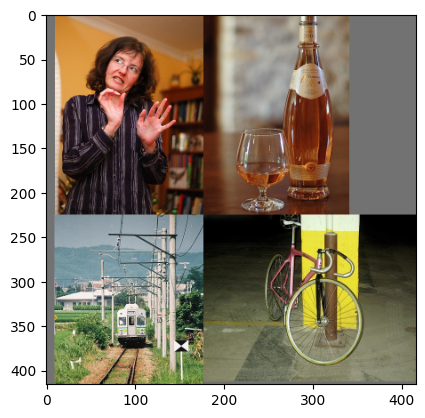

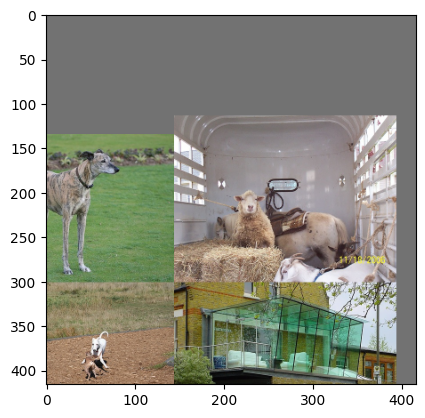

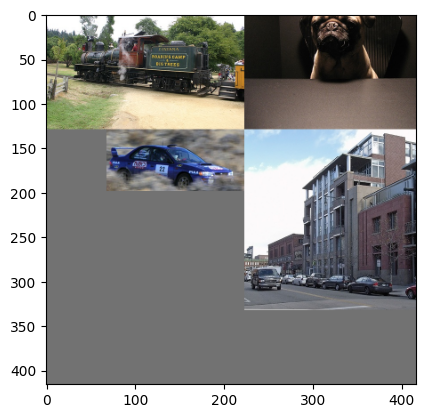

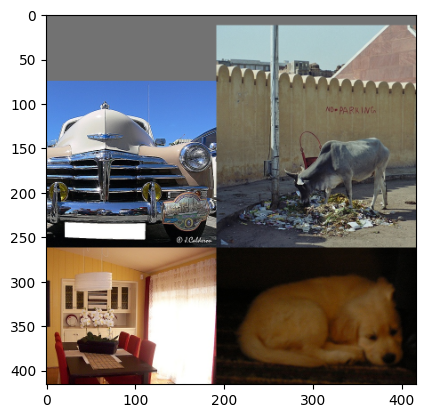

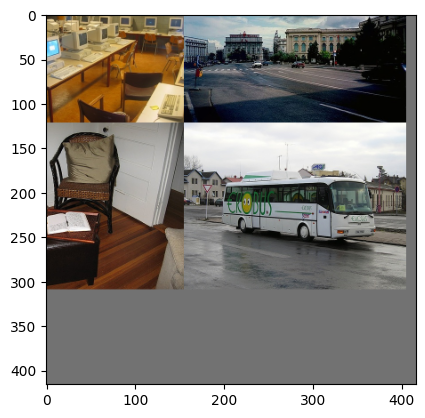

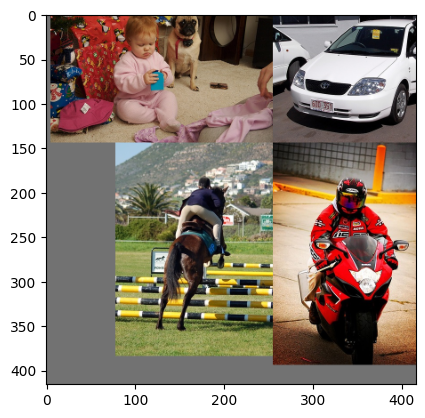

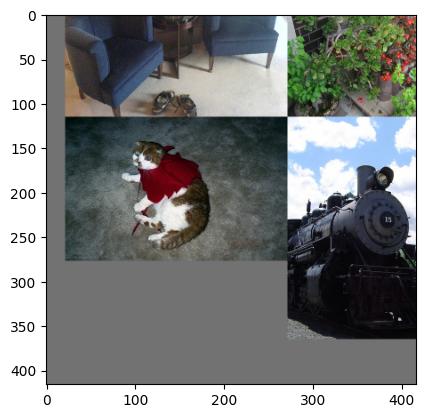

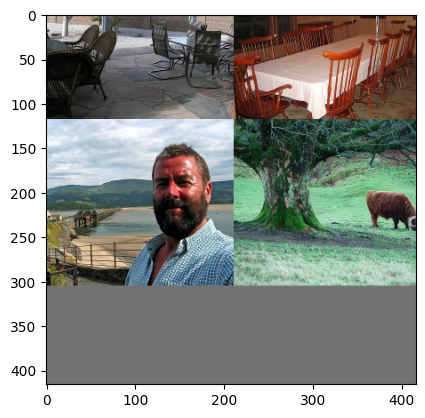

100%|██████████| 518/518 [23:21<00:00,  2.71s/it, loss=21.6] 


=> Saving checkpoint
Currently epoch 0
On Train loader:


100%|██████████| 518/518 [09:08<00:00,  1.06s/it]


Class accuracy is: 32.917736%
No obj accuracy is: 73.846855%
Obj accuracy is: 26.260258%


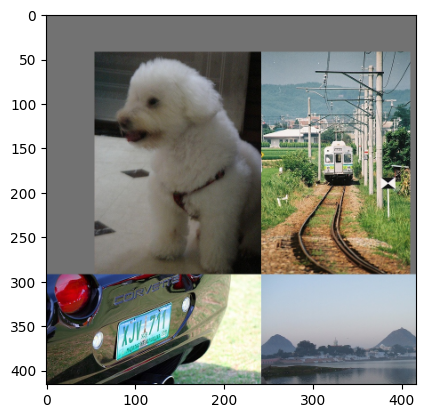

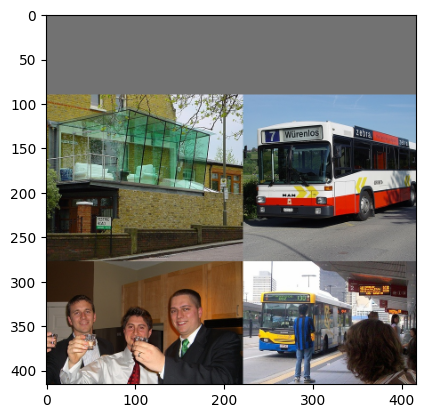

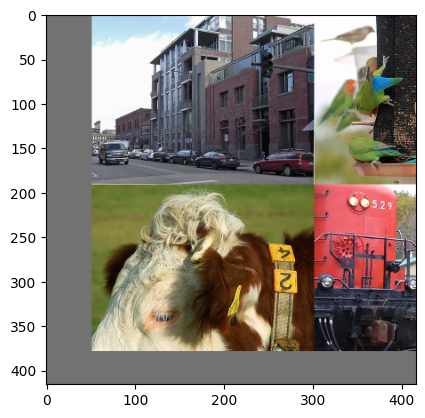

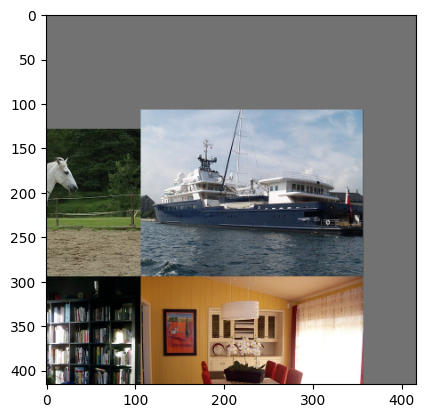

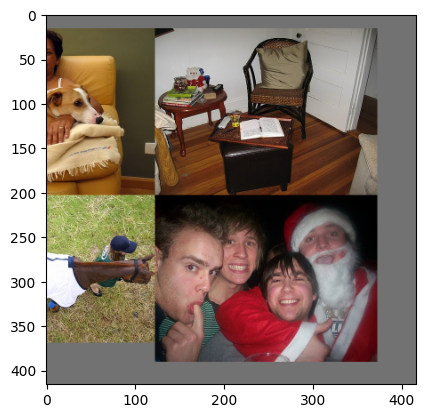

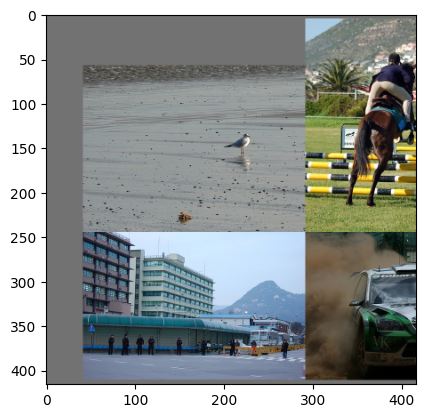

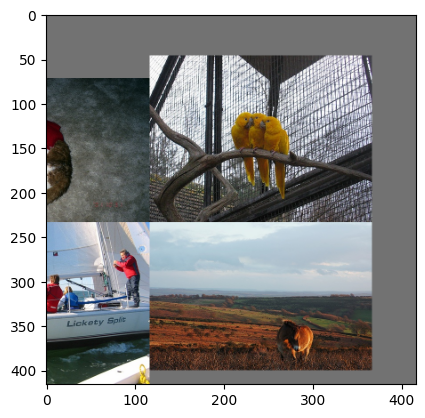

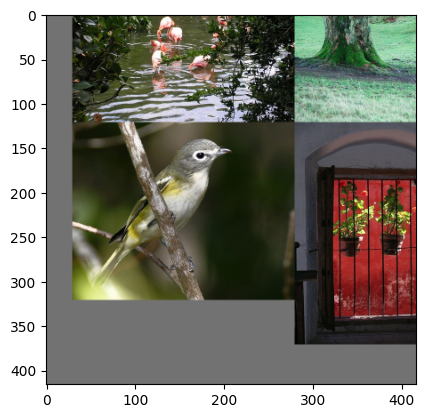

100%|██████████| 518/518 [10:56<00:00,  1.27s/it, loss=12.7]


=> Saving checkpoint
Currently epoch 1
On Train loader:


100%|██████████| 518/518 [09:16<00:00,  1.07s/it]


Class accuracy is: 35.957249%
No obj accuracy is: 95.777191%
Obj accuracy is: 27.729488%


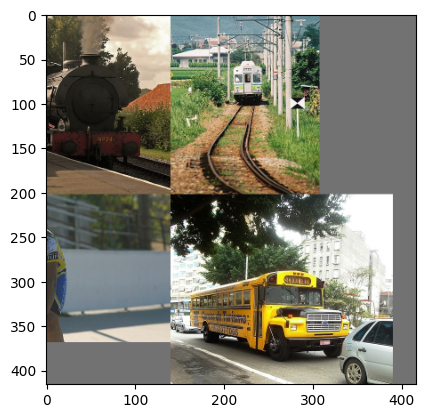

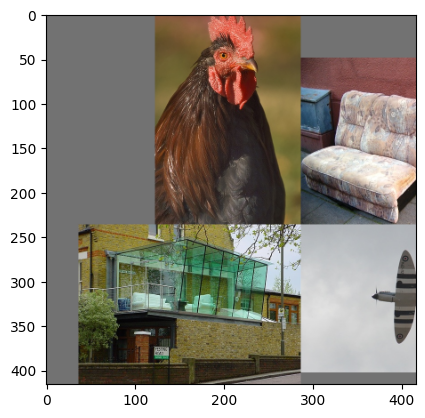

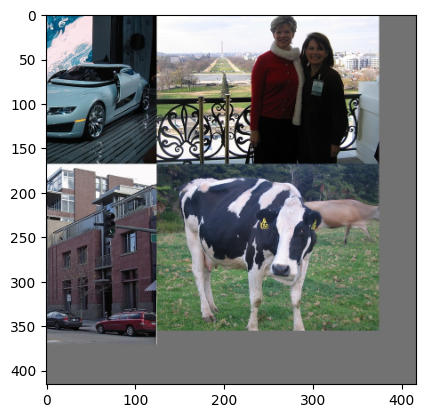

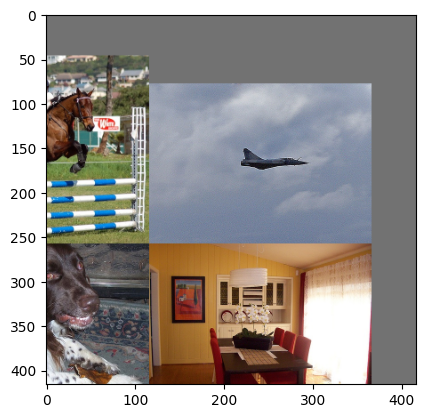

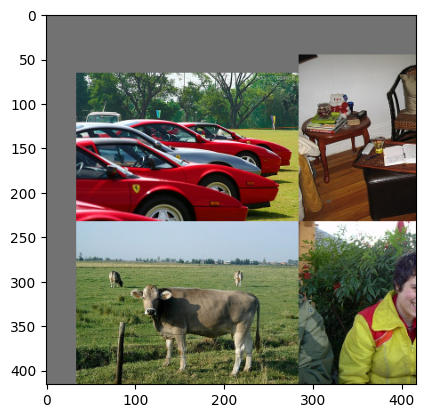

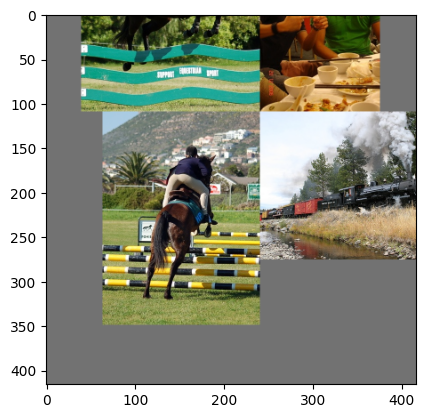

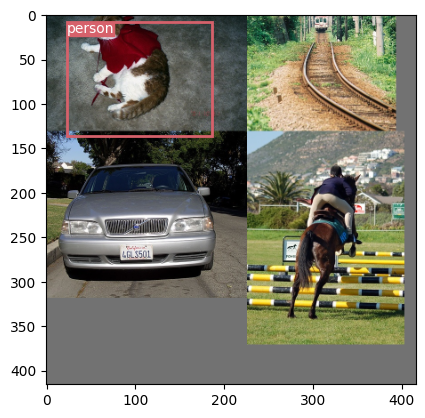

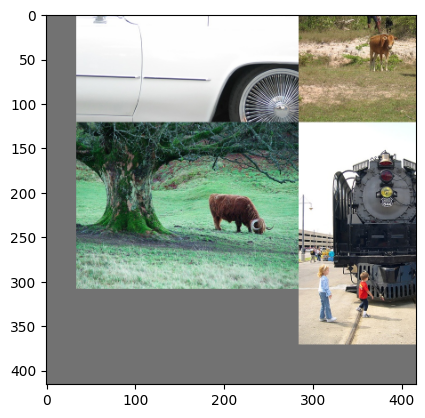

100%|██████████| 518/518 [10:52<00:00,  1.26s/it, loss=11]  


=> Saving checkpoint
Currently epoch 2
On Train loader:


100%|██████████| 518/518 [09:13<00:00,  1.07s/it]


Class accuracy is: 37.642376%
No obj accuracy is: 97.542969%
Obj accuracy is: 28.139629%


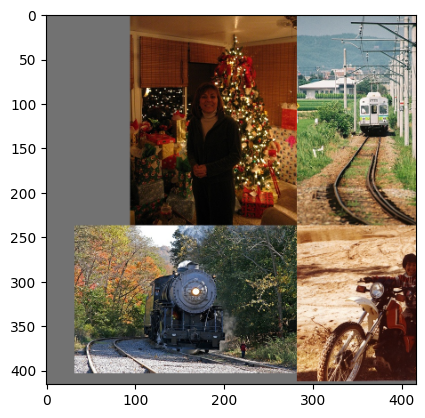

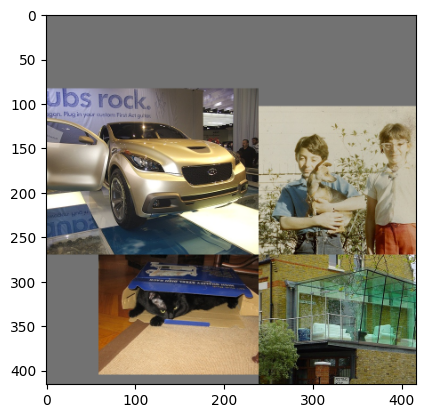

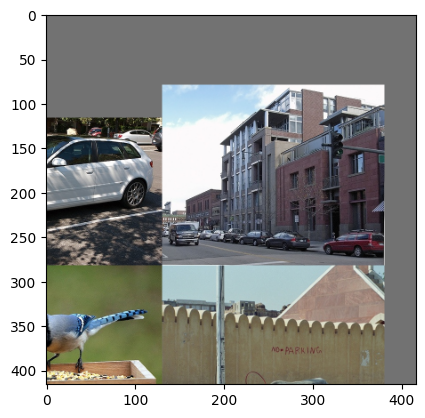

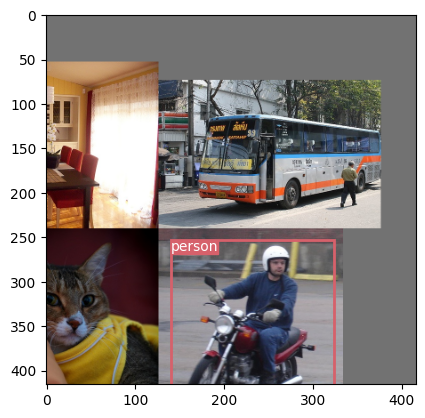

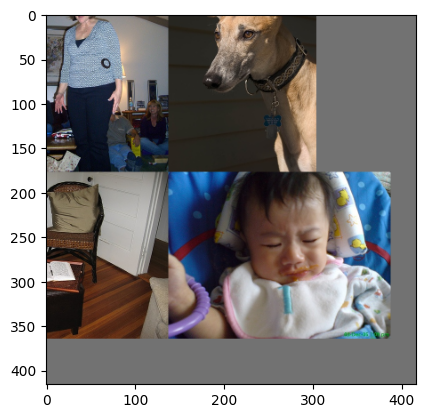

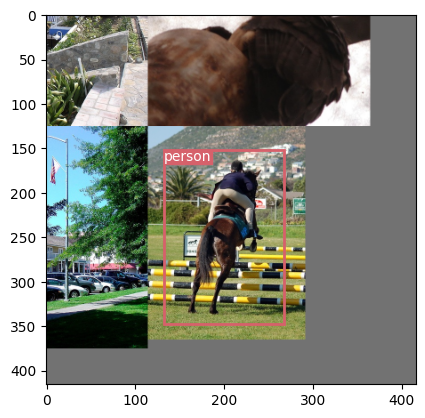

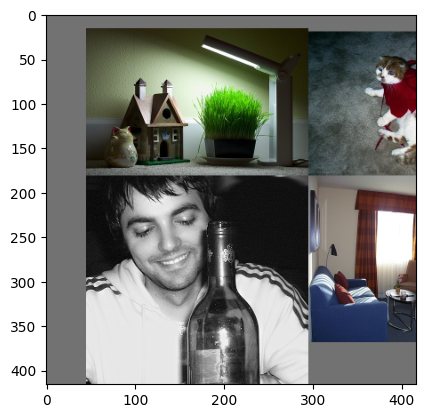

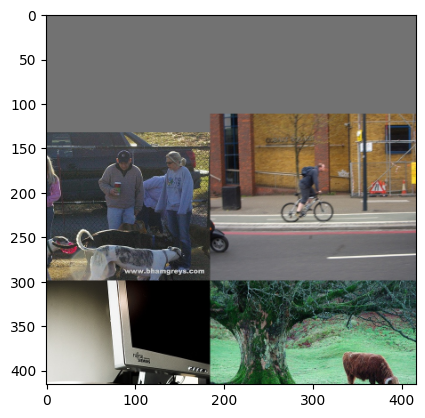

100%|██████████| 518/518 [10:47<00:00,  1.25s/it, loss=10]  


=> Saving checkpoint
Currently epoch 3
On Train loader:


100%|██████████| 518/518 [09:02<00:00,  1.05s/it]


Class accuracy is: 43.631229%
No obj accuracy is: 94.880745%
Obj accuracy is: 55.939102%


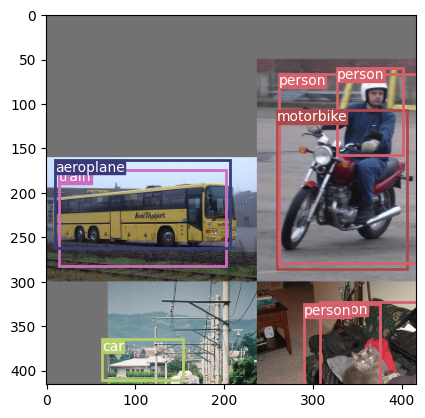

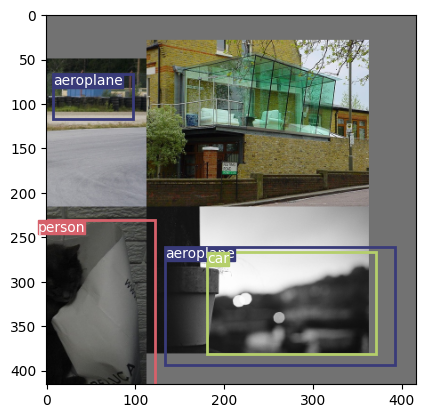

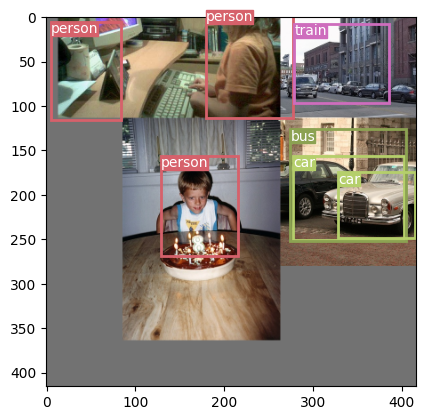

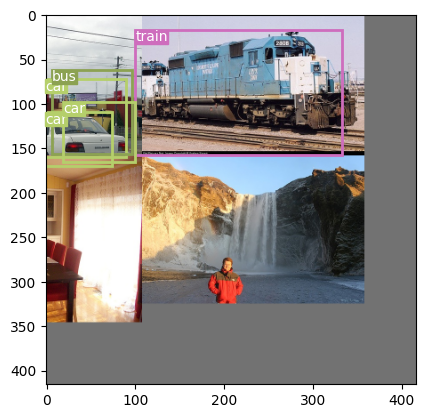

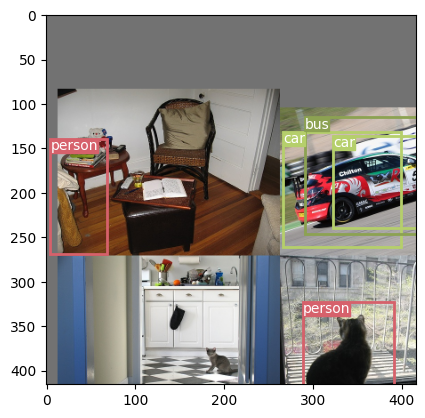

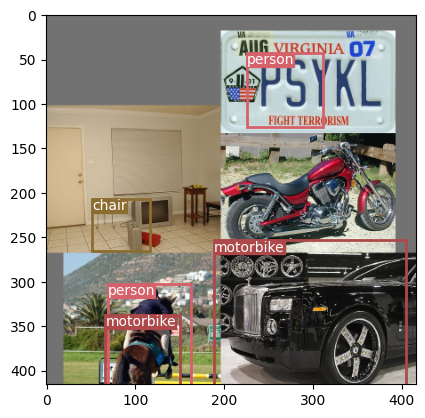

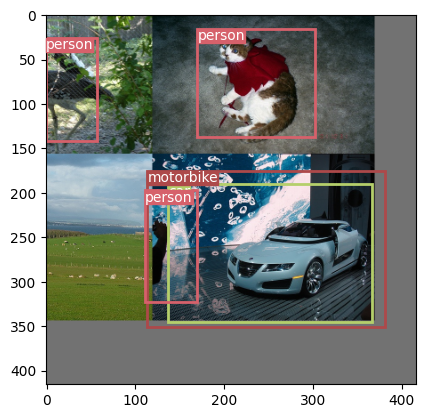

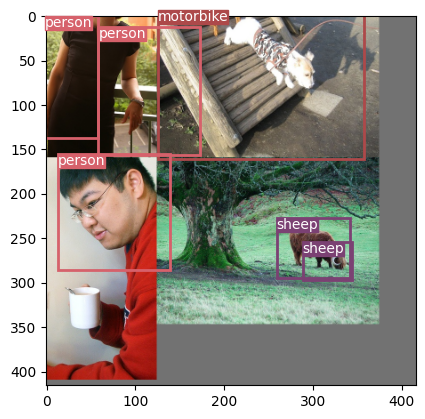

100%|██████████| 518/518 [11:05<00:00,  1.28s/it, loss=9.32]


=> Saving checkpoint
Currently epoch 4
On Train loader:


100%|██████████| 518/518 [09:48<00:00,  1.14s/it]


Class accuracy is: 46.607815%
No obj accuracy is: 95.289322%
Obj accuracy is: 55.150352%


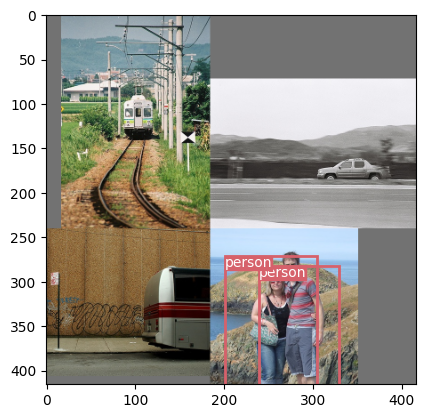

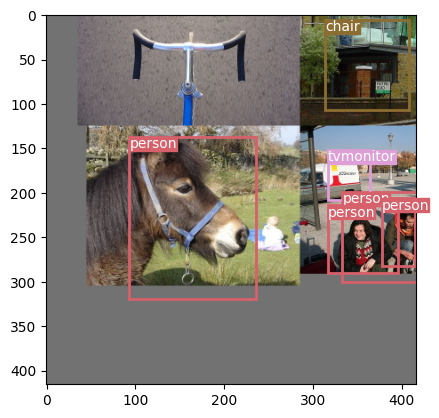

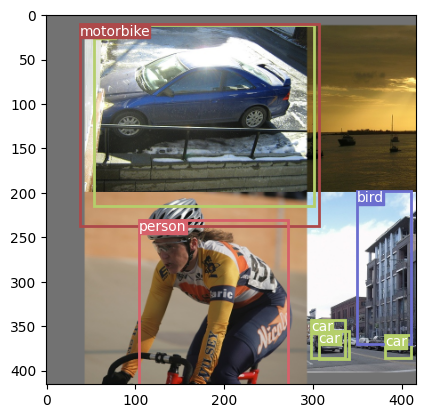

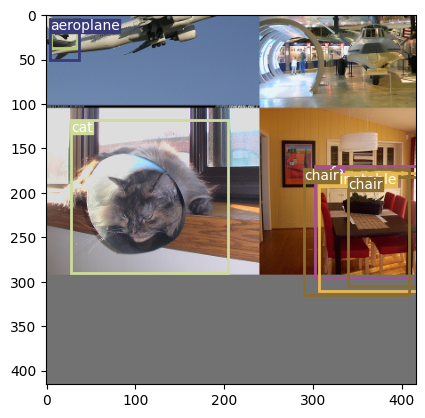

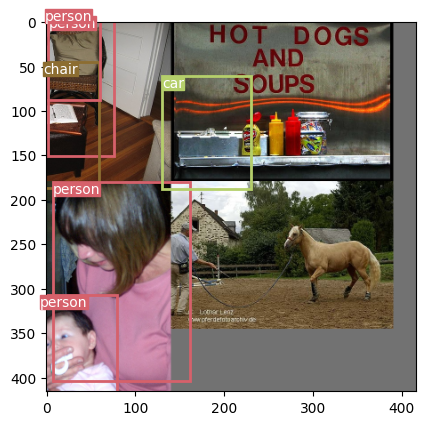

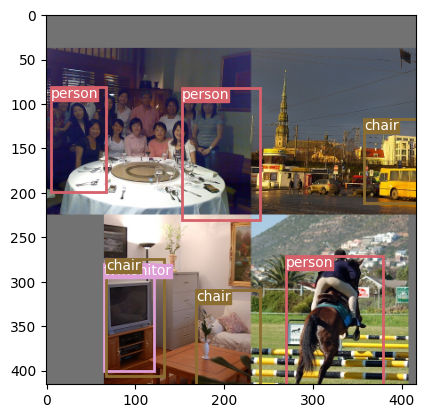

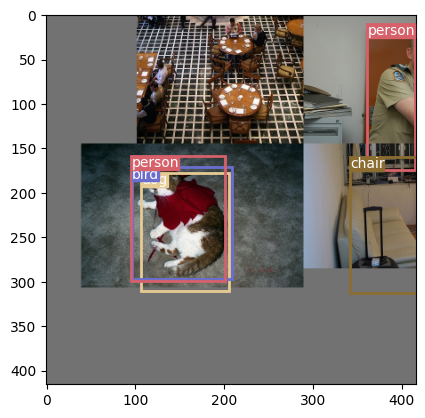

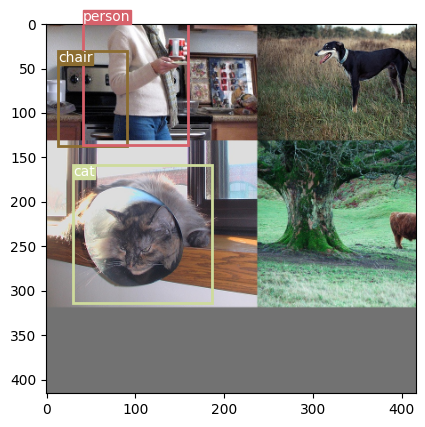

100%|██████████| 518/518 [11:36<00:00,  1.34s/it, loss=8.65]


=> Saving checkpoint
Currently epoch 5
On Train loader:


100%|██████████| 518/518 [09:45<00:00,  1.13s/it]


Class accuracy is: 46.520481%
No obj accuracy is: 97.030373%
Obj accuracy is: 48.092976%


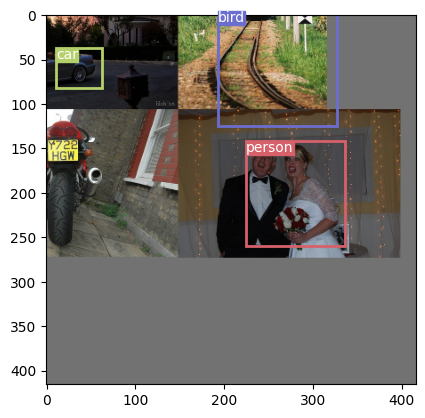

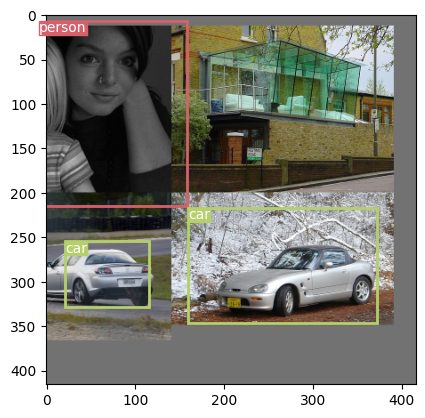

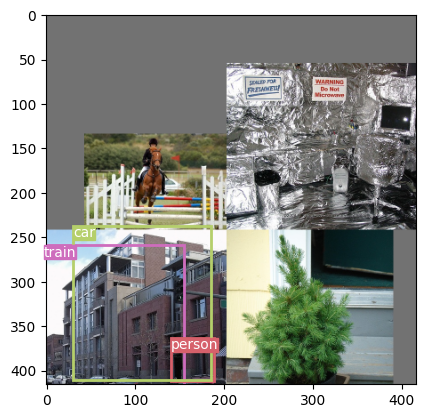

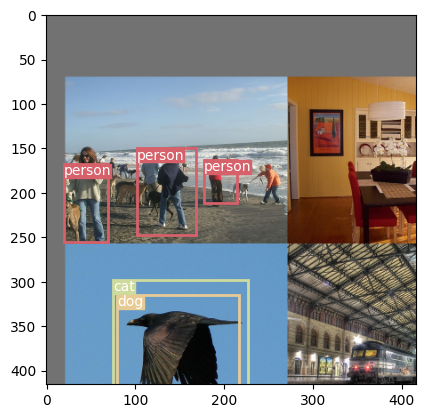

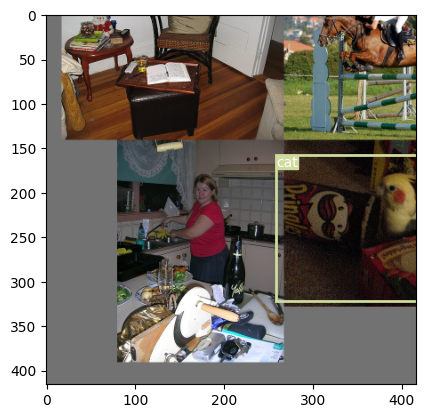

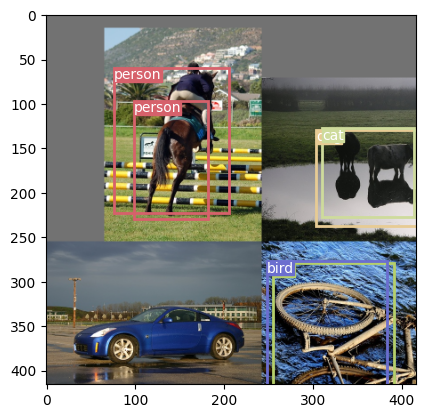

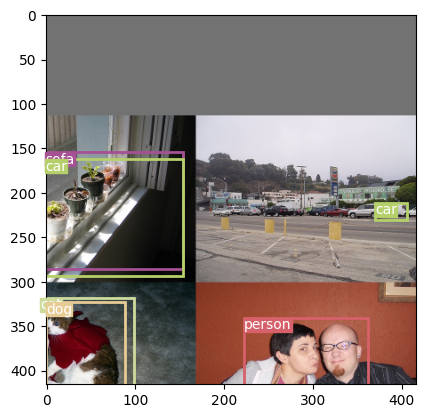

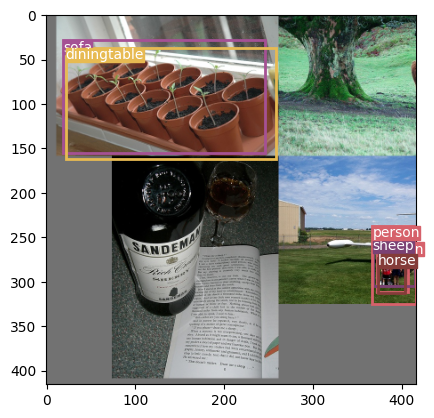

100%|██████████| 518/518 [11:42<00:00,  1.36s/it, loss=8.08]


=> Saving checkpoint
Currently epoch 6
On Train loader:


100%|██████████| 518/518 [09:44<00:00,  1.13s/it]


Class accuracy is: 54.430302%
No obj accuracy is: 96.682625%
Obj accuracy is: 60.092354%


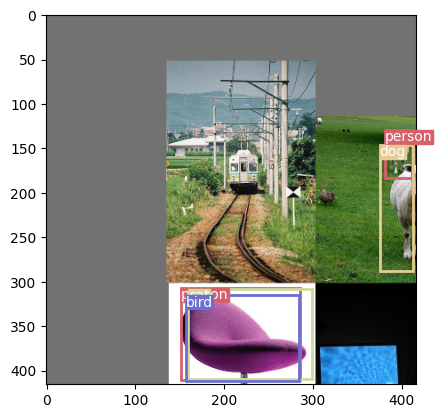

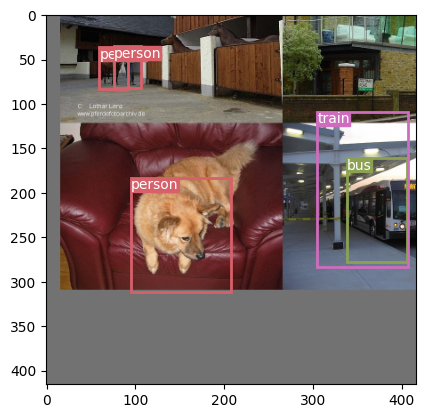

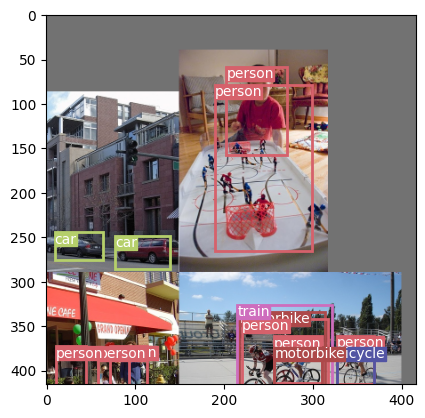

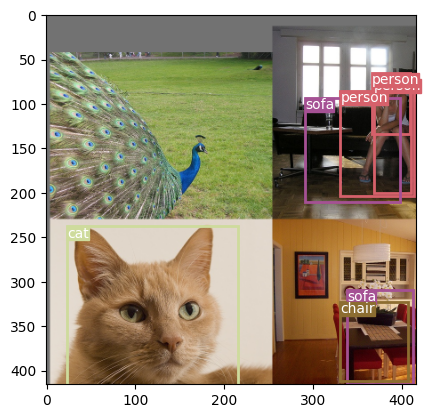

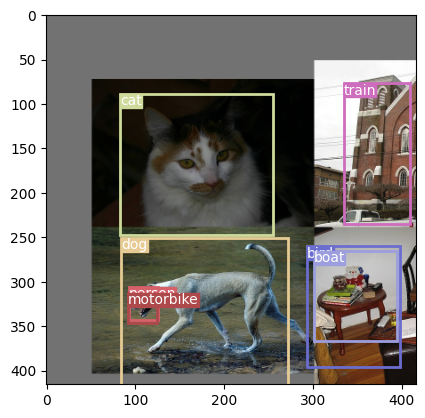

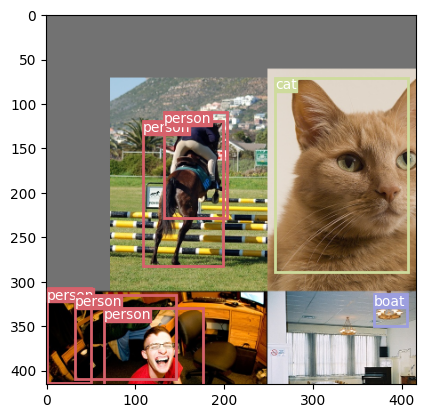

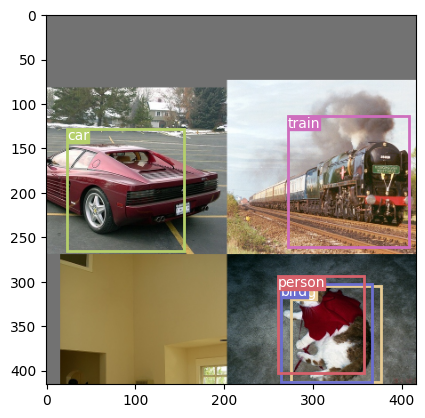

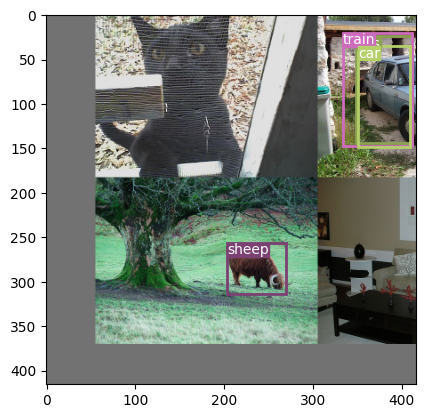

100%|██████████| 518/518 [11:34<00:00,  1.34s/it, loss=7.76]


=> Saving checkpoint
Currently epoch 7
On Train loader:


100%|██████████| 518/518 [10:41<00:00,  1.24s/it]


Class accuracy is: 51.478737%
No obj accuracy is: 96.012444%
Obj accuracy is: 59.344650%


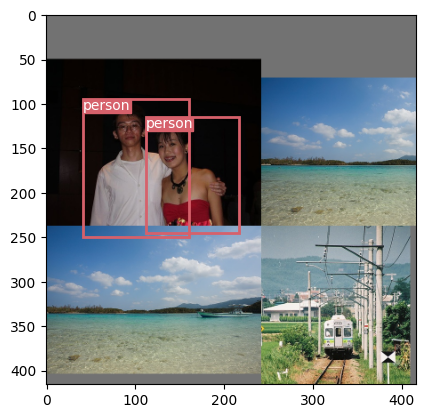

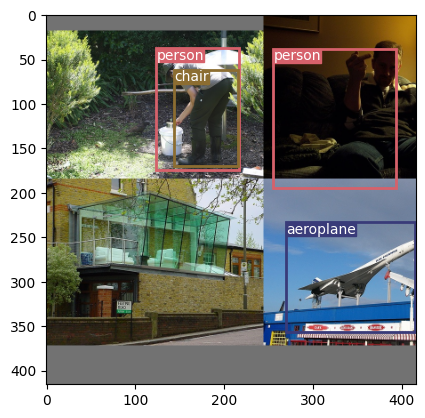

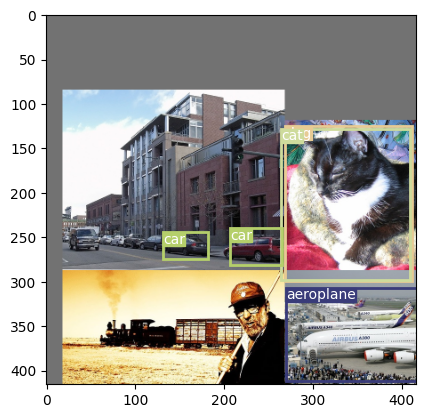

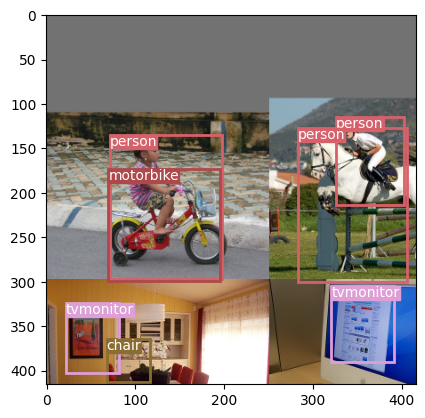

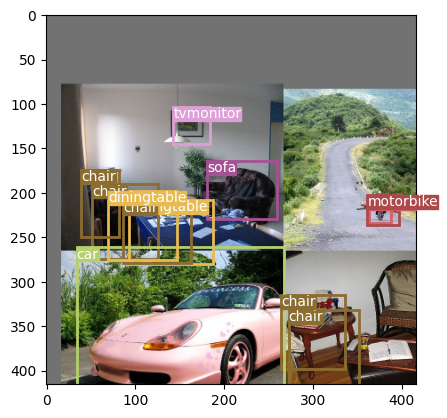

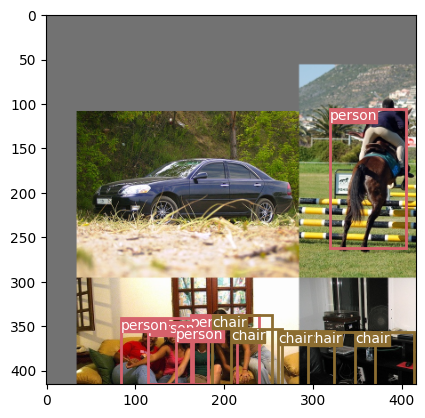

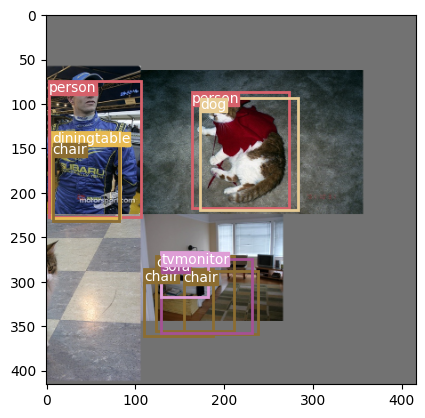

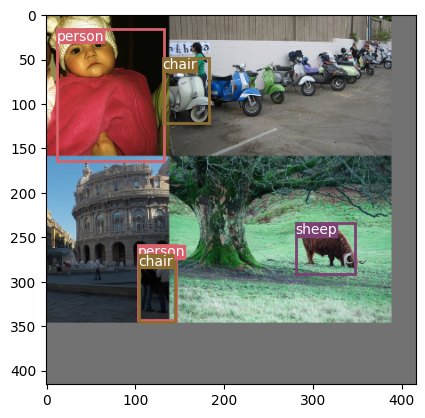

100%|██████████| 518/518 [12:24<00:00,  1.44s/it, loss=7.44]


=> Saving checkpoint
Currently epoch 8
On Train loader:


100%|██████████| 518/518 [10:07<00:00,  1.17s/it]


Class accuracy is: 55.472416%
No obj accuracy is: 97.507439%
Obj accuracy is: 57.343620%


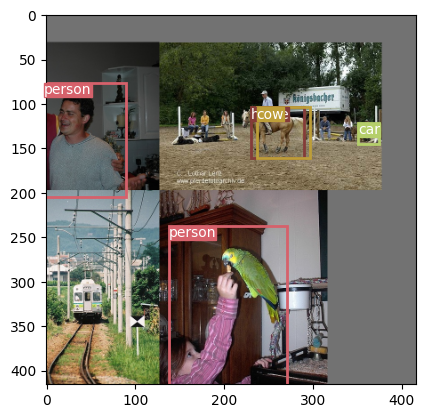

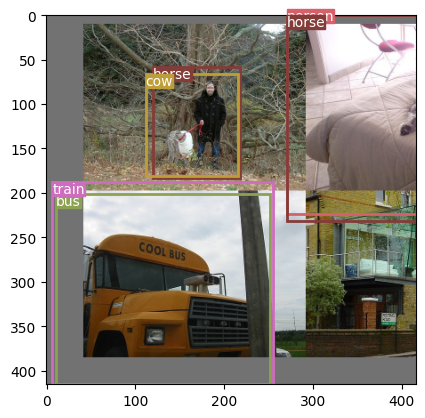

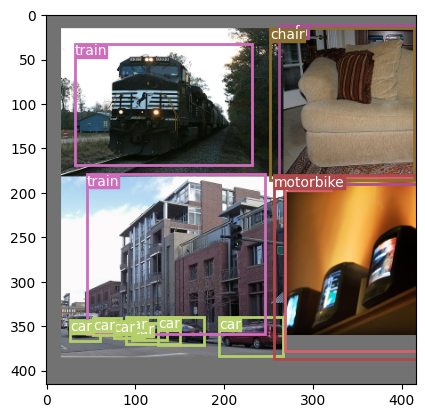

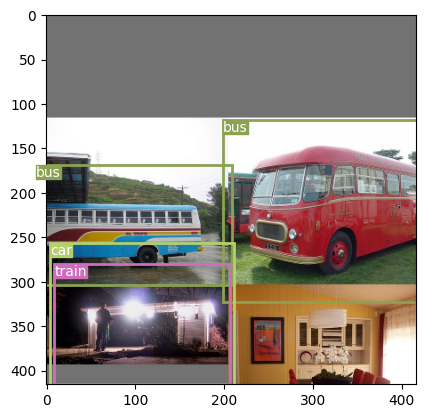

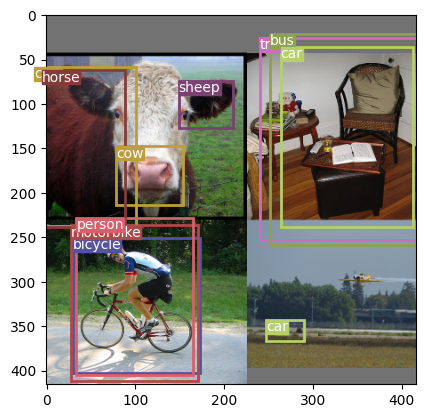

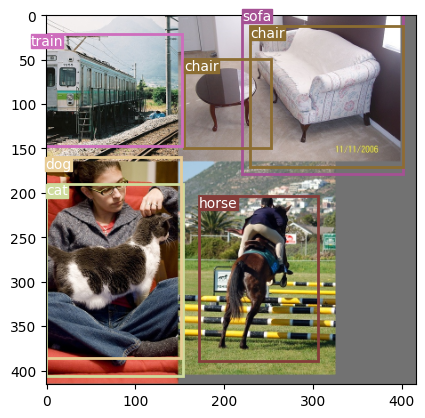

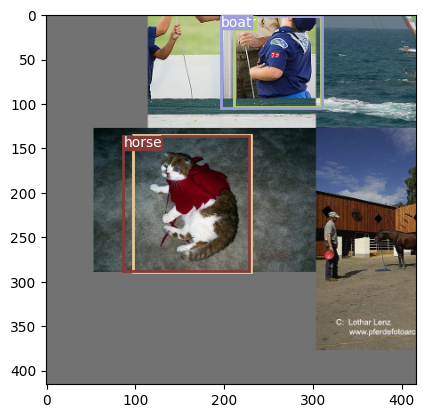

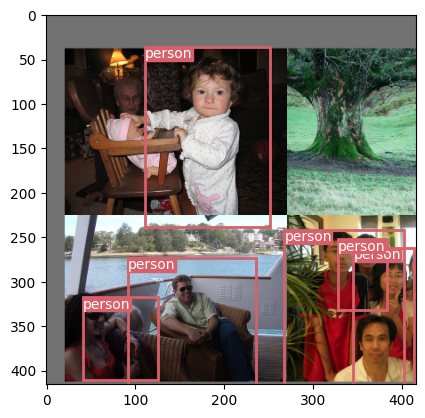

100%|██████████| 518/518 [13:33<00:00,  1.57s/it, loss=7.07]


=> Saving checkpoint
Currently epoch 9
On Train loader:


100%|██████████| 518/518 [09:12<00:00,  1.07s/it]


Class accuracy is: 58.436619%
No obj accuracy is: 96.431656%
Obj accuracy is: 65.301743%


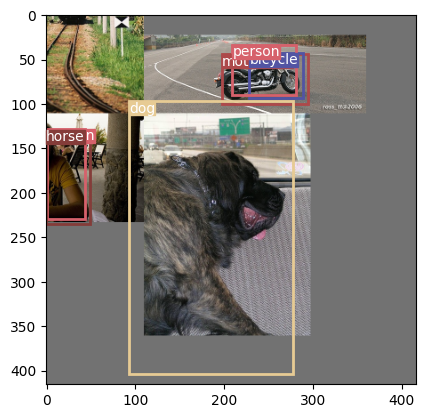

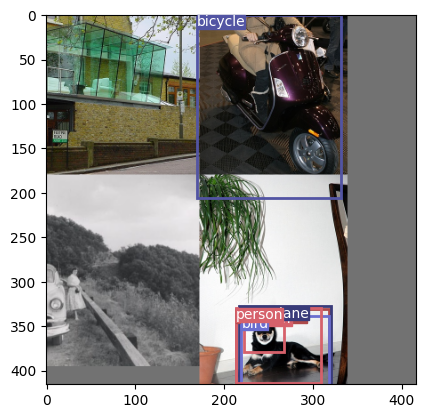

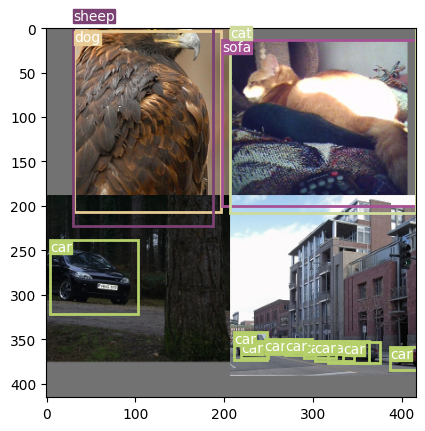

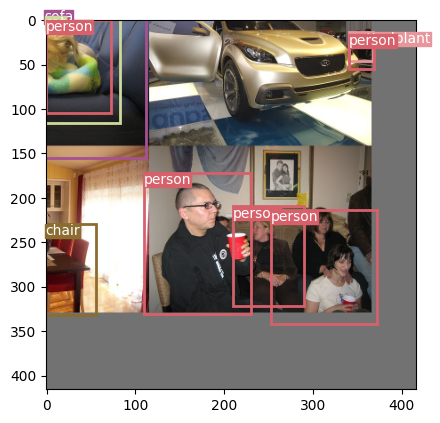

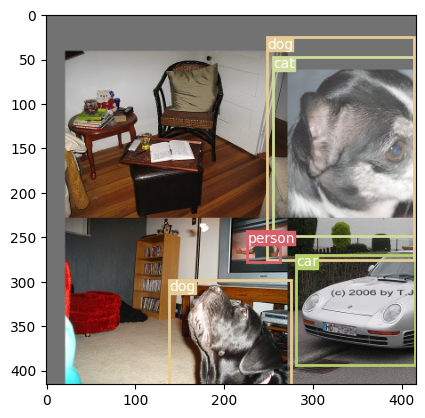

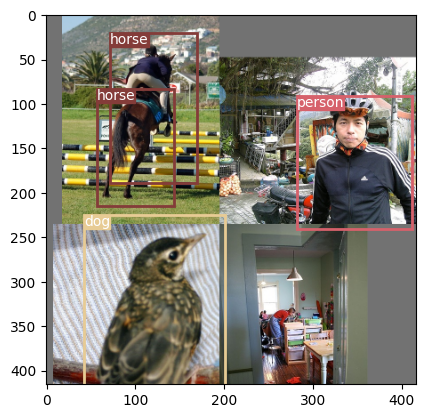

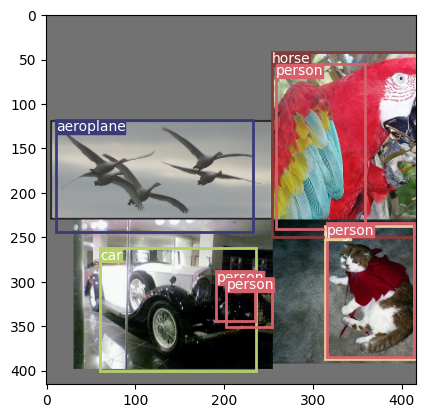

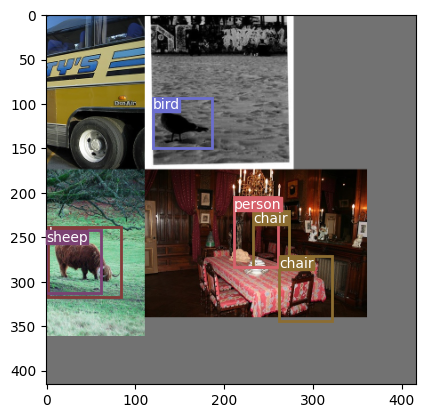

100%|██████████| 518/518 [11:02<00:00,  1.28s/it, loss=6.82]


=> Saving checkpoint
Currently epoch 10
On Train loader:


100%|██████████| 518/518 [08:33<00:00,  1.01it/s]


Class accuracy is: 62.196739%
No obj accuracy is: 97.046265%
Obj accuracy is: 64.931808%


100%|██████████| 155/155 [03:18<00:00,  1.28s/it]


Class accuracy is: 68.349350%
No obj accuracy is: 96.677887%
Obj accuracy is: 63.791561%


100%|██████████| 155/155 [34:42<00:00, 13.44s/it]


MAP: 0.20339158177375793


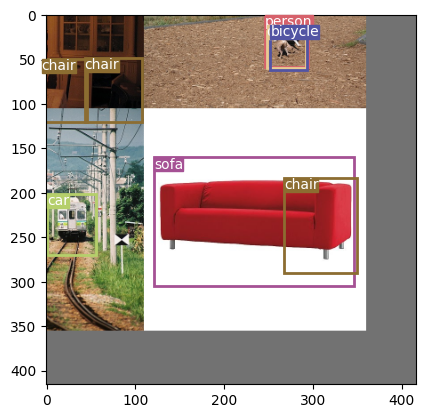

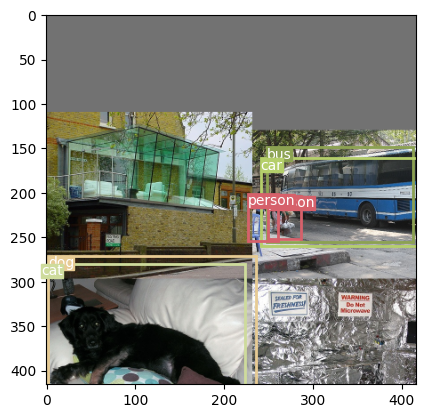

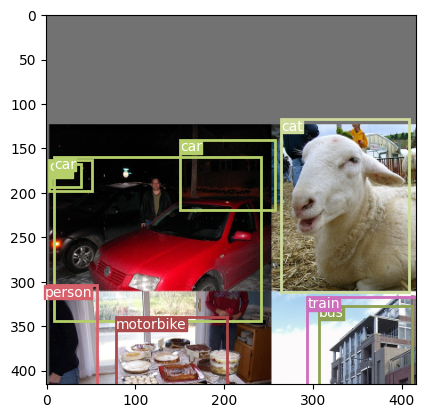

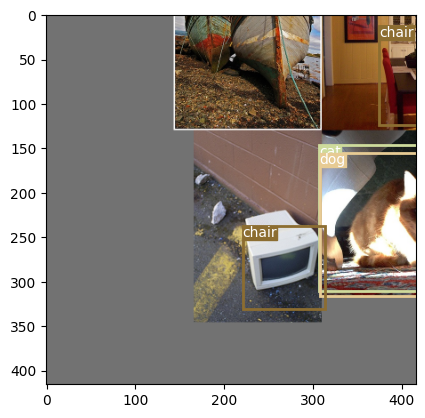

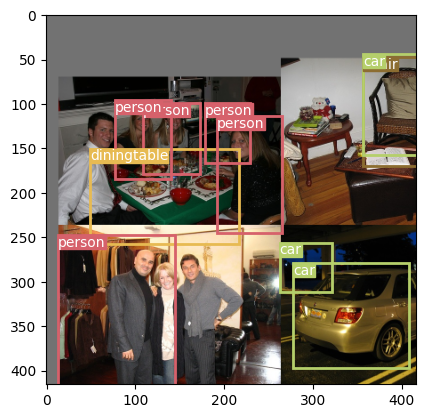

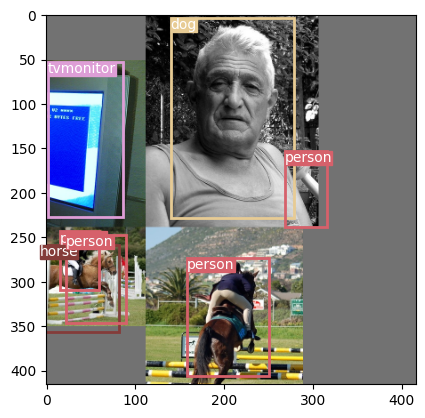

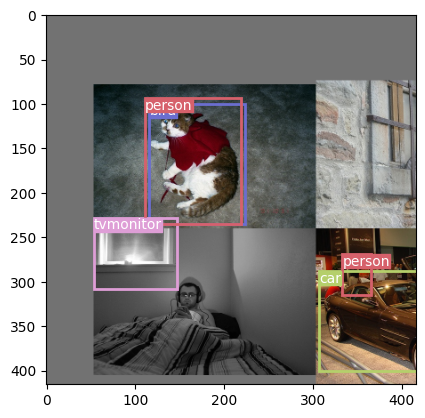

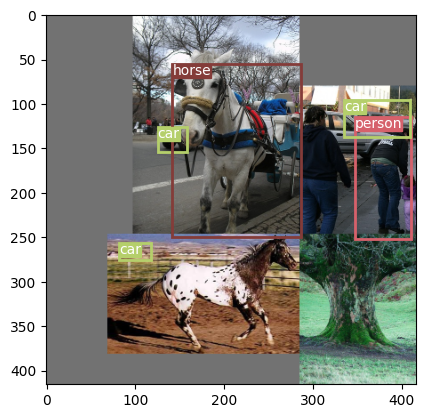

100%|██████████| 518/518 [09:10<00:00,  1.06s/it, loss=6.63]


=> Saving checkpoint
Currently epoch 11
On Train loader:


100%|██████████| 518/518 [08:47<00:00,  1.02s/it]


Class accuracy is: 63.092659%
No obj accuracy is: 97.310722%
Obj accuracy is: 65.689468%


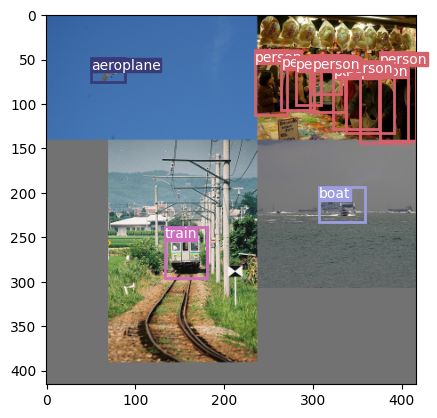

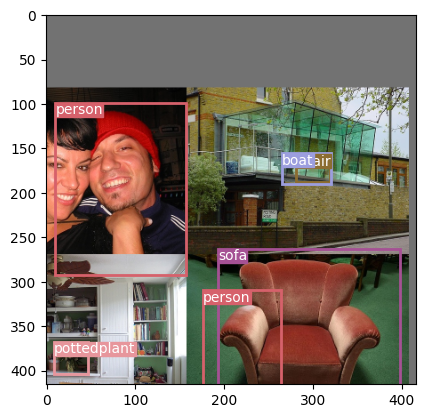

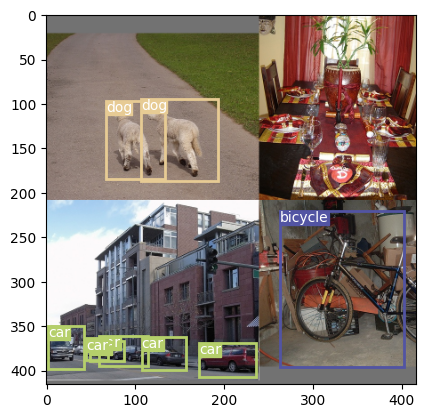

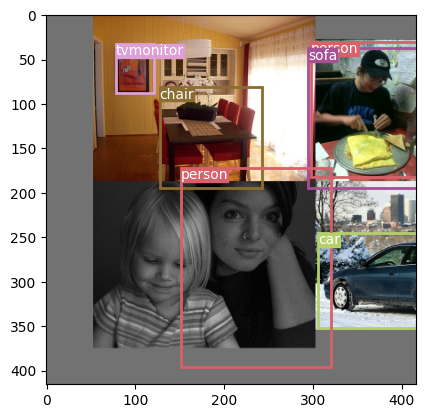

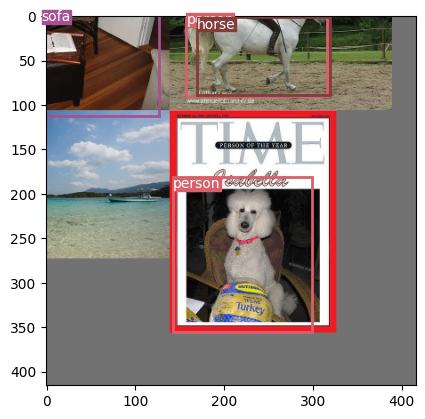

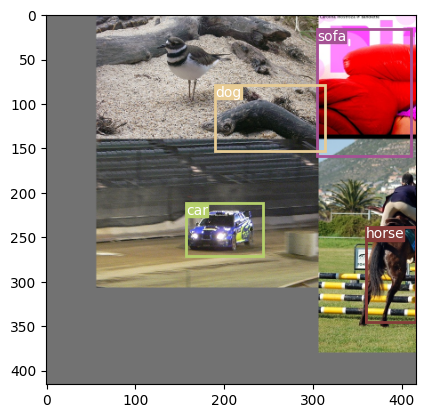

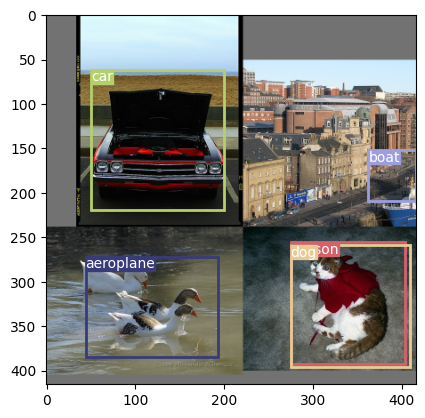

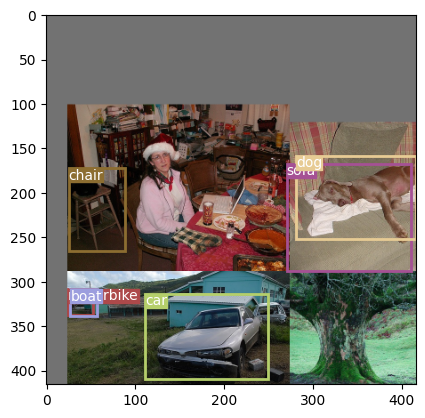

100%|██████████| 518/518 [09:41<00:00,  1.12s/it, loss=6.29]


=> Saving checkpoint
Currently epoch 12
On Train loader:


100%|██████████| 518/518 [07:51<00:00,  1.10it/s]


Class accuracy is: 62.685268%
No obj accuracy is: 97.543808%
Obj accuracy is: 66.963402%


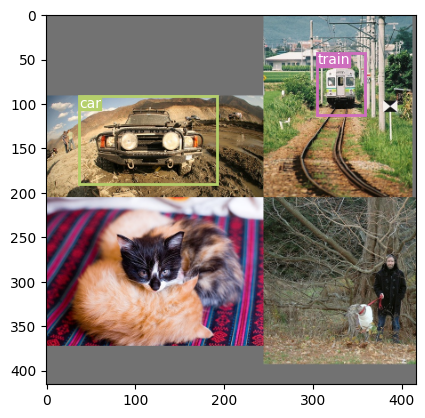

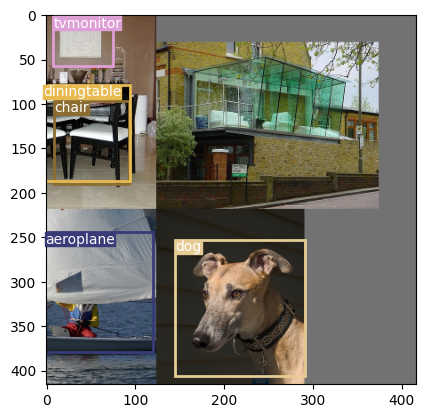

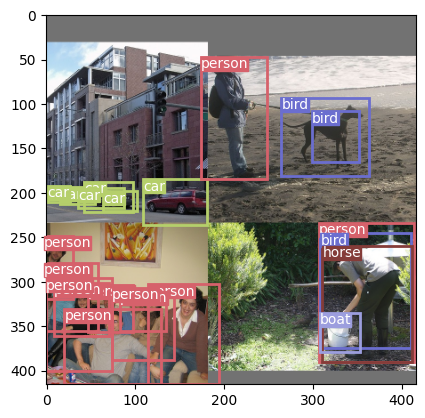

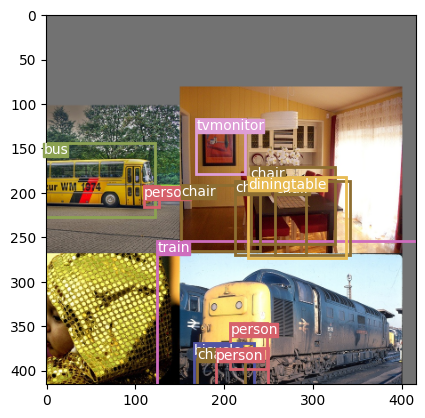

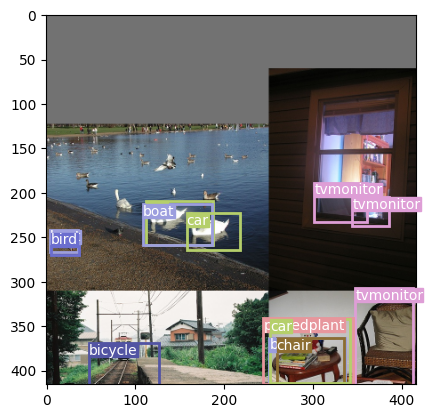

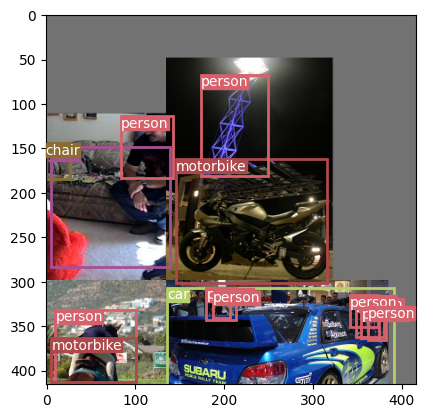

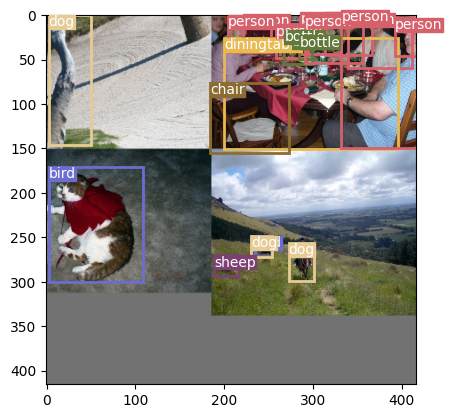

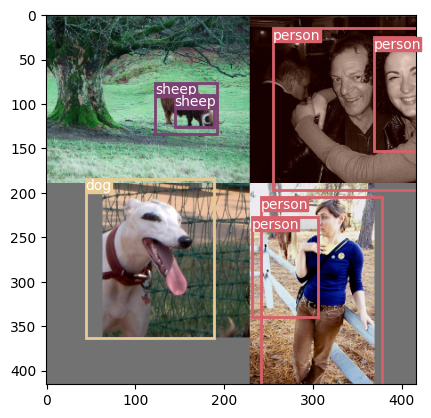

100%|██████████| 518/518 [09:10<00:00,  1.06s/it, loss=6.08]


=> Saving checkpoint
Currently epoch 13
On Train loader:


100%|██████████| 518/518 [07:53<00:00,  1.09it/s]


Class accuracy is: 64.568077%
No obj accuracy is: 97.292076%
Obj accuracy is: 68.498993%


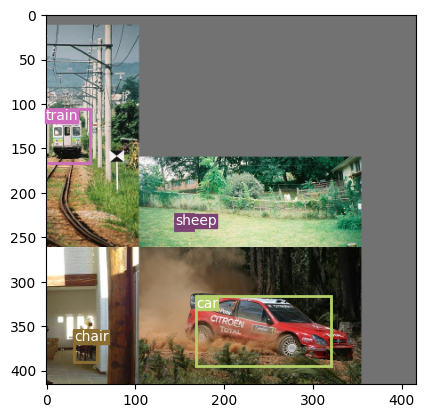

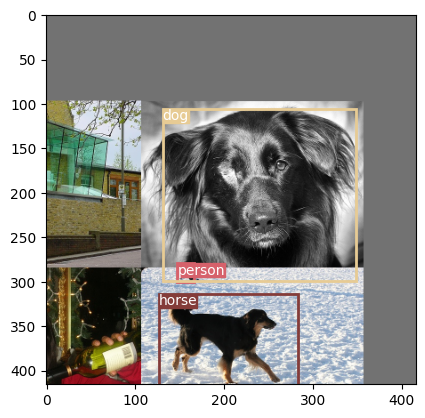

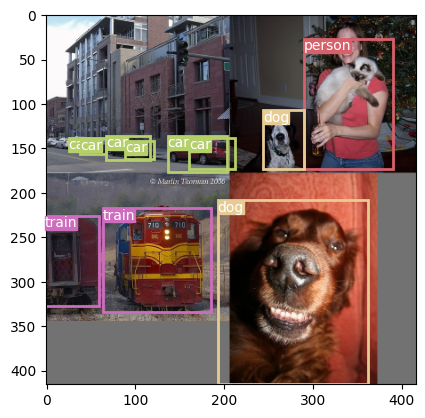

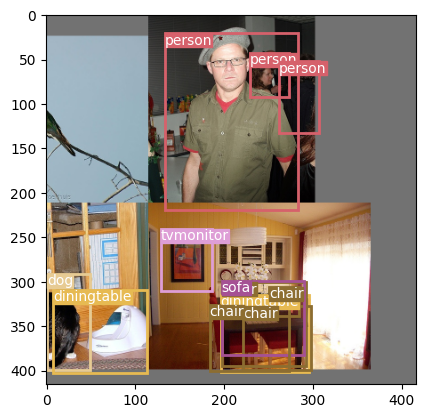

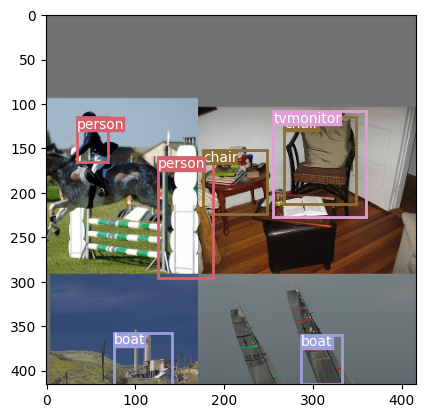

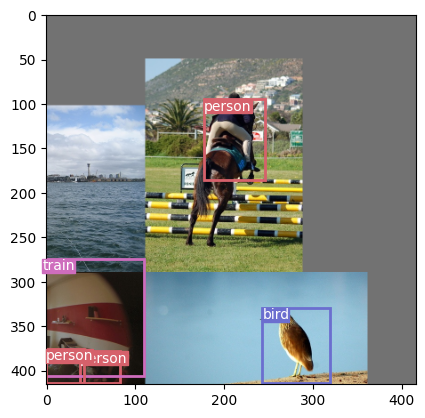

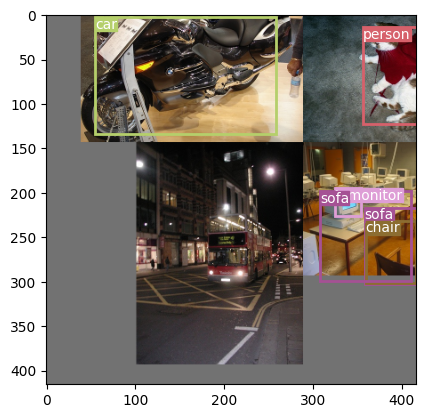

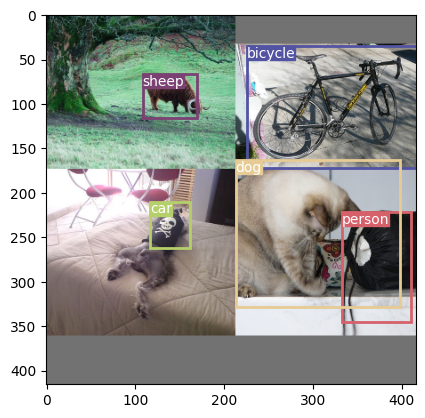

100%|██████████| 518/518 [09:11<00:00,  1.07s/it, loss=5.88]


=> Saving checkpoint
Currently epoch 14
On Train loader:


100%|██████████| 518/518 [07:53<00:00,  1.09it/s]


Class accuracy is: 70.536926%
No obj accuracy is: 97.962364%
Obj accuracy is: 65.103951%


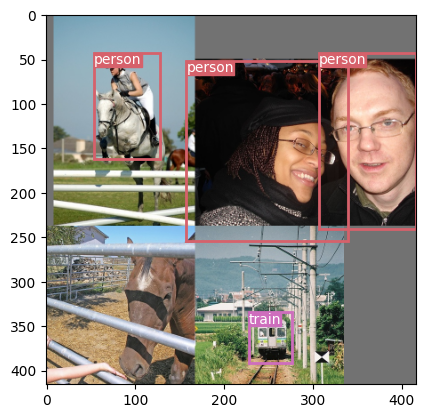

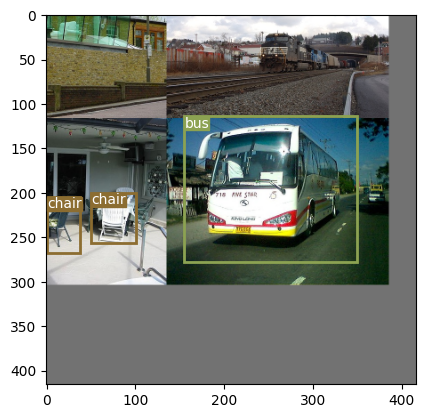

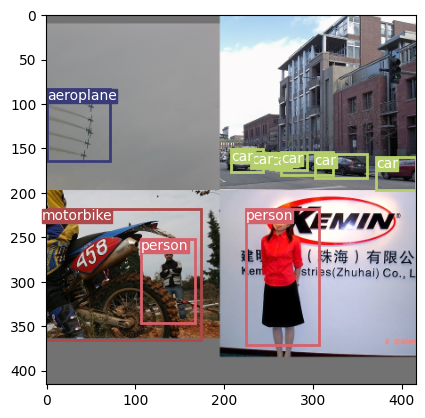

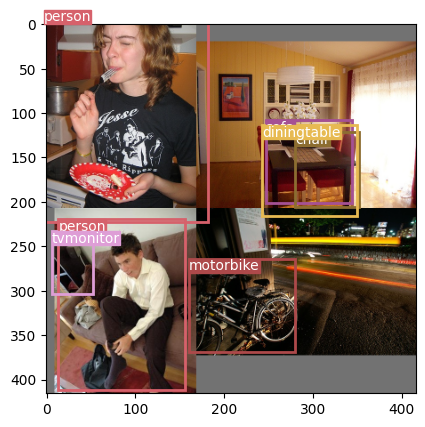

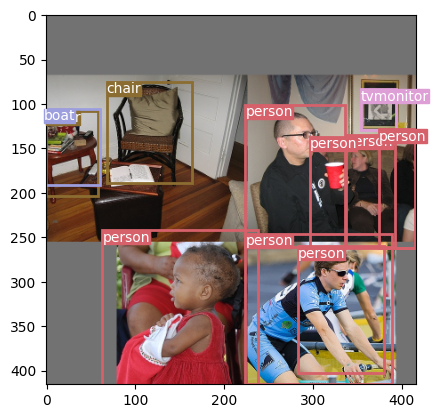

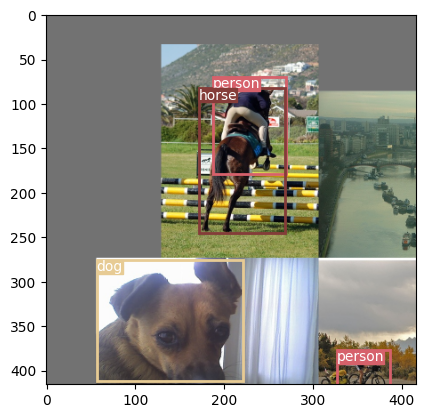

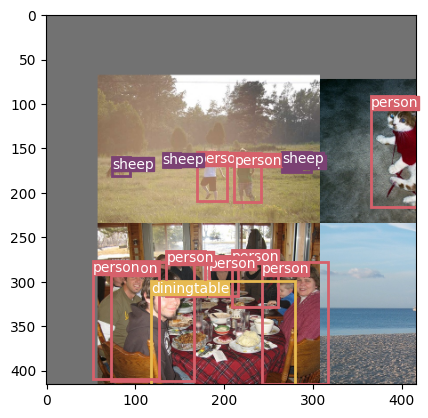

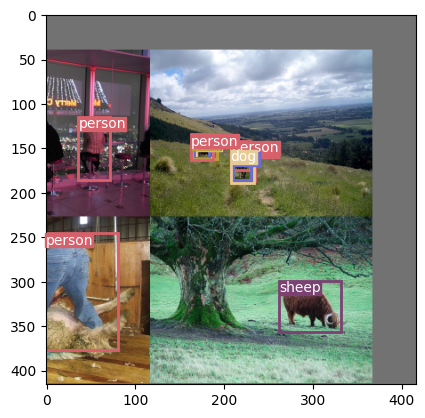

100%|██████████| 518/518 [09:10<00:00,  1.06s/it, loss=5.54]


=> Saving checkpoint
Currently epoch 15
On Train loader:


100%|██████████| 518/518 [07:51<00:00,  1.10it/s]


Class accuracy is: 71.461601%
No obj accuracy is: 97.888161%
Obj accuracy is: 68.499031%


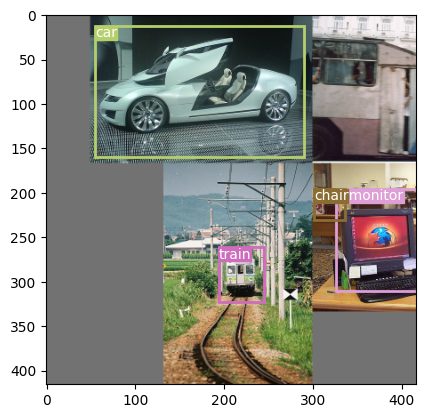

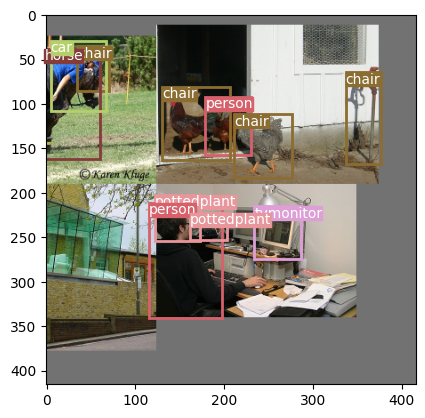

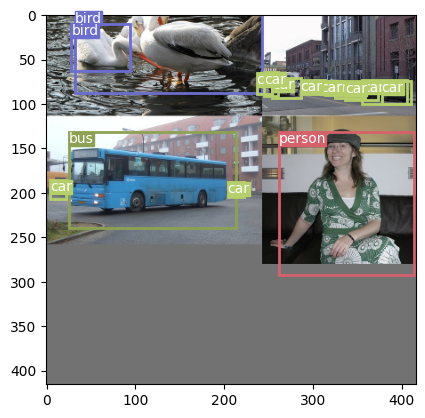

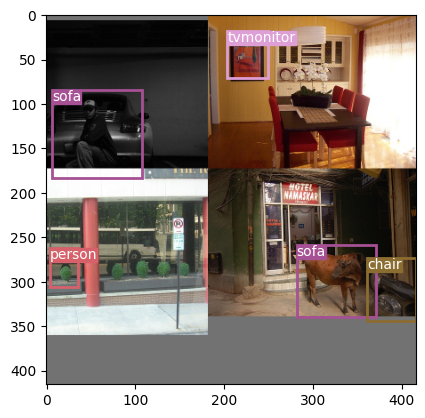

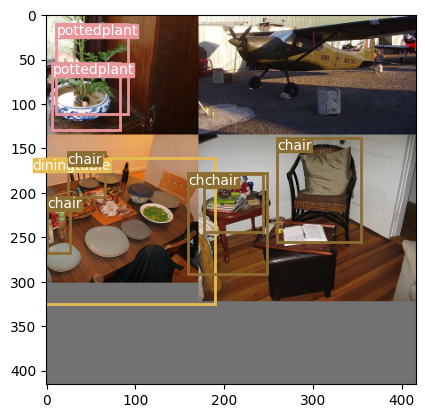

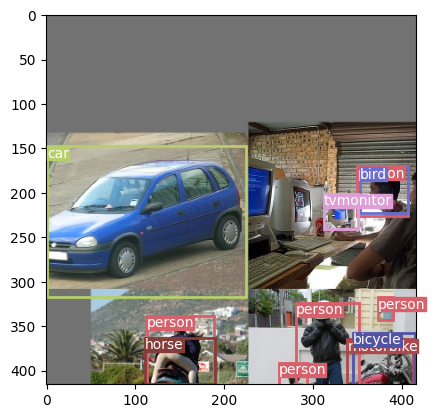

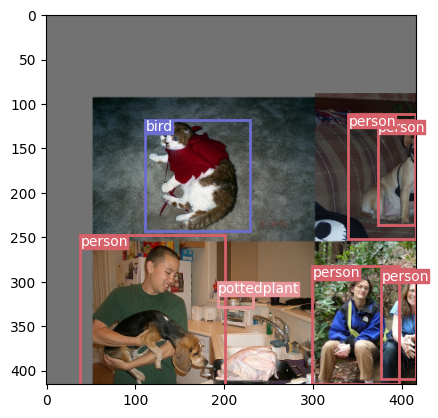

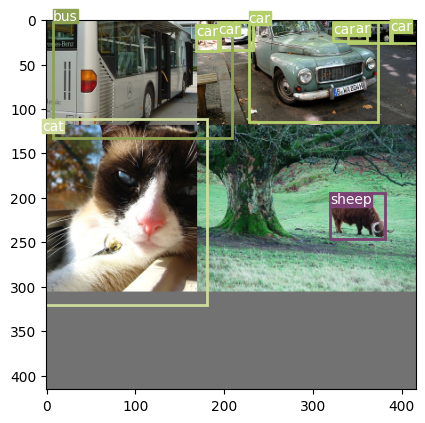

100%|██████████| 518/518 [09:08<00:00,  1.06s/it, loss=5.31]


=> Saving checkpoint
Currently epoch 16
On Train loader:


100%|██████████| 518/518 [07:49<00:00,  1.10it/s]


Class accuracy is: 74.836487%
No obj accuracy is: 97.780479%
Obj accuracy is: 71.797539%


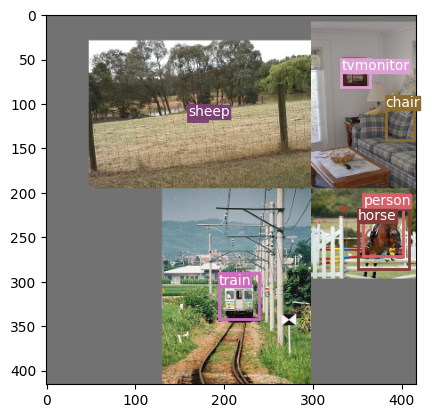

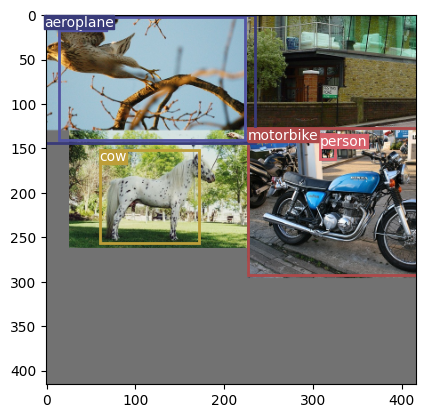

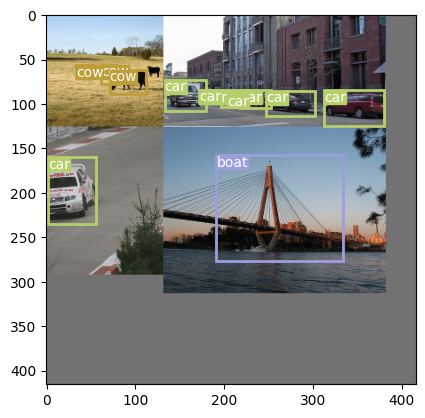

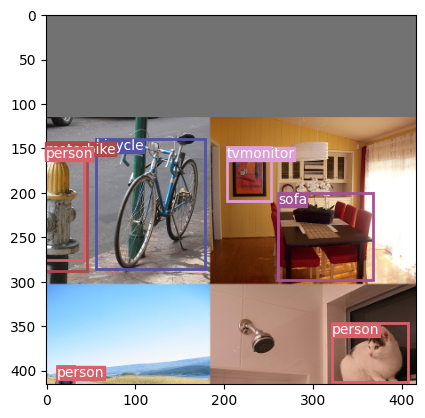

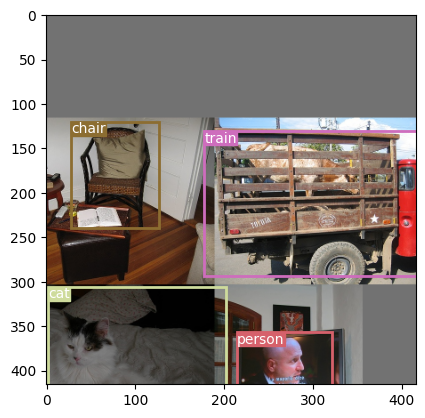

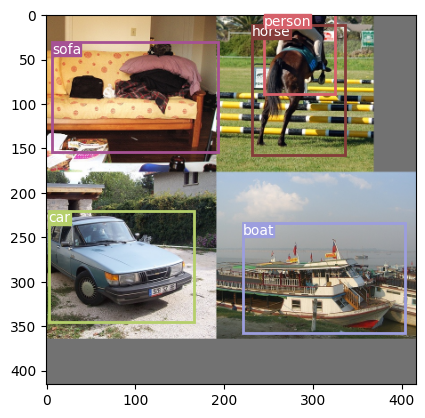

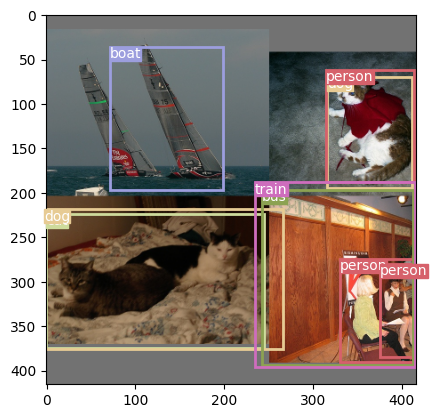

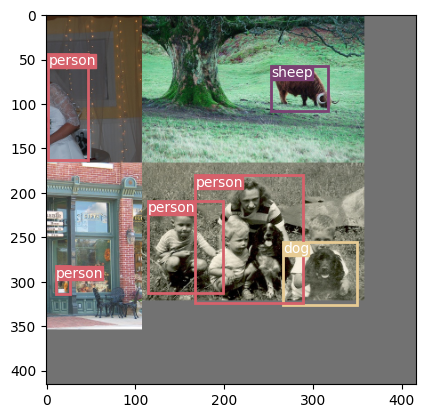

100%|██████████| 518/518 [09:10<00:00,  1.06s/it, loss=5]   


=> Saving checkpoint
Currently epoch 17
On Train loader:


100%|██████████| 518/518 [07:51<00:00,  1.10it/s]


Class accuracy is: 77.479446%
No obj accuracy is: 97.613319%
Obj accuracy is: 74.761406%


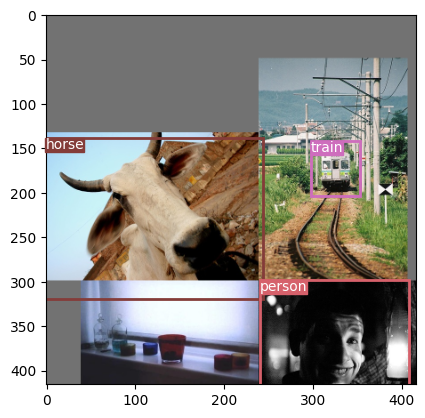

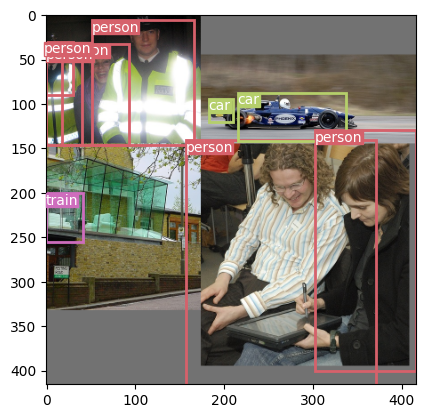

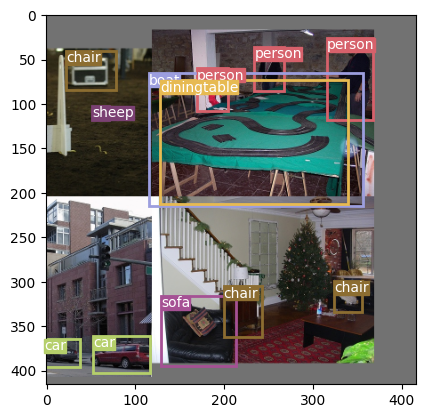

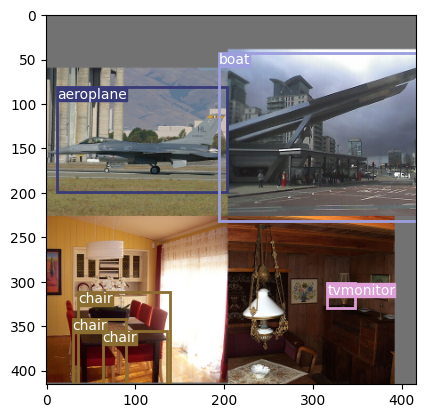

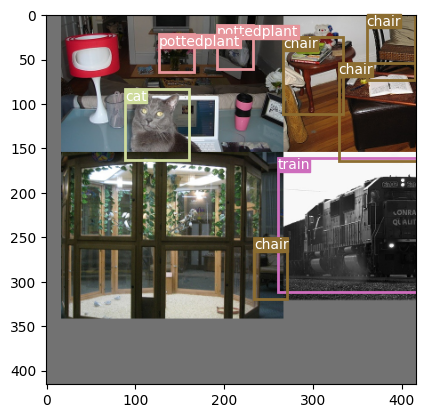

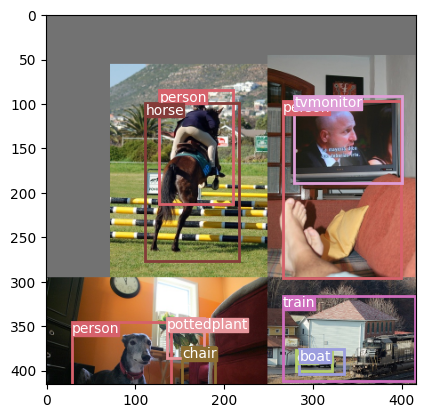

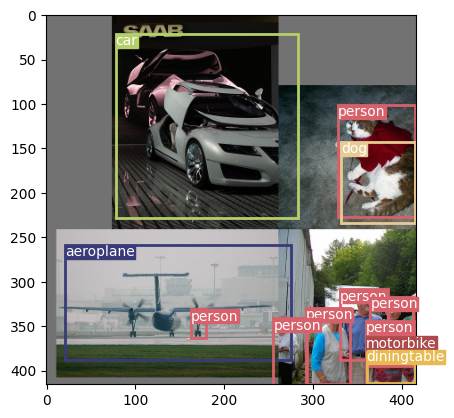

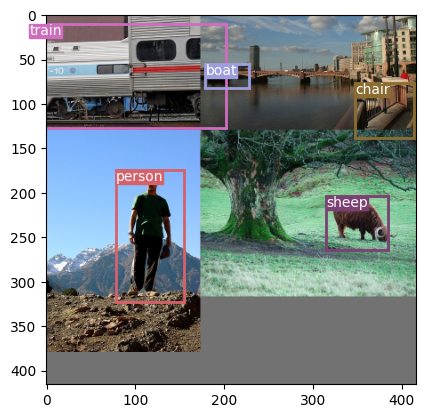

100%|██████████| 518/518 [09:10<00:00,  1.06s/it, loss=4.7] 


=> Saving checkpoint
Currently epoch 18
On Train loader:


100%|██████████| 518/518 [07:51<00:00,  1.10it/s]


Class accuracy is: 79.407524%
No obj accuracy is: 97.731071%
Obj accuracy is: 75.695465%


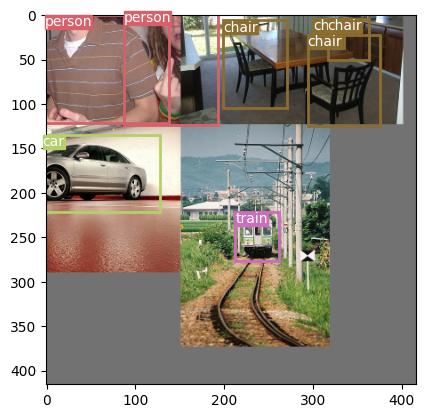

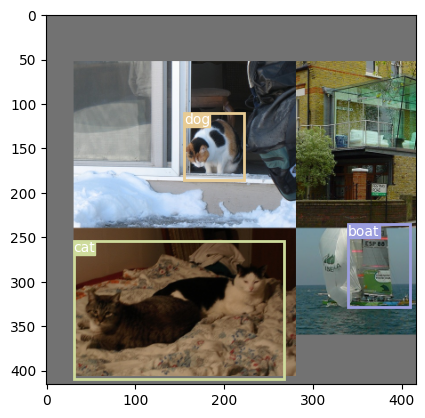

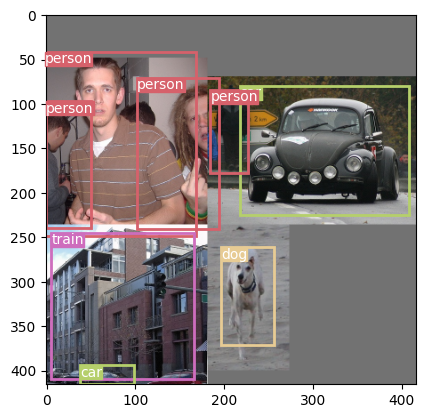

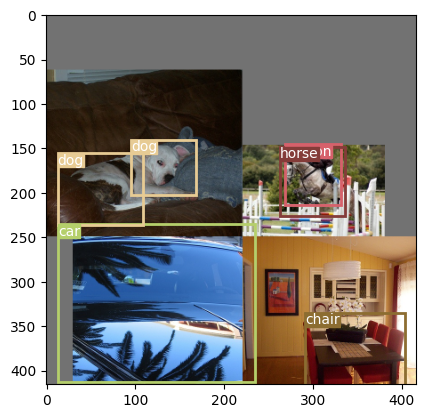

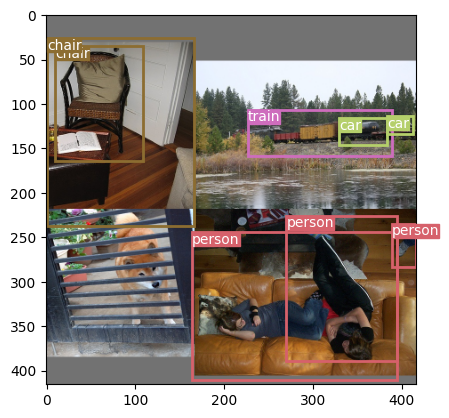

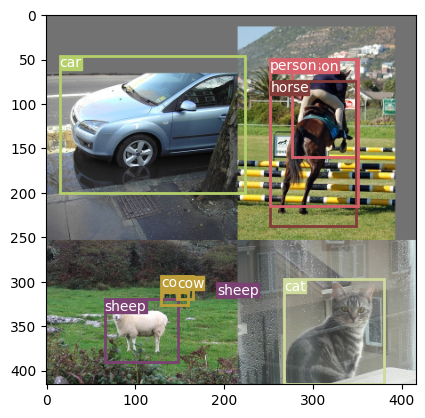

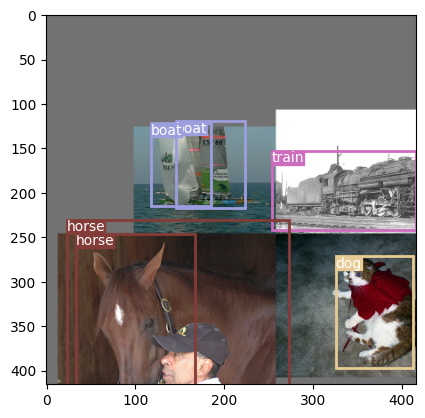

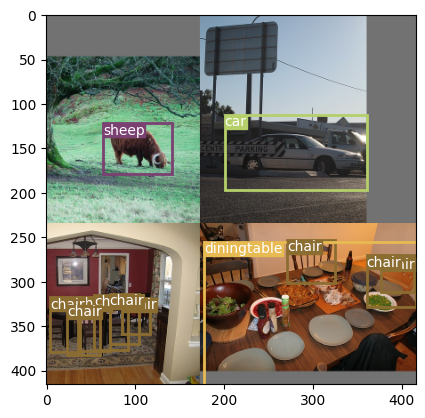

100%|██████████| 518/518 [09:06<00:00,  1.05s/it, loss=4.47]


=> Saving checkpoint
Currently epoch 19
On Train loader:


100%|██████████| 518/518 [07:49<00:00,  1.10it/s]

Class accuracy is: 80.889915%
No obj accuracy is: 97.817253%
Obj accuracy is: 75.926224%


In [7]:
scaled_anchors = (
    torch.tensor(config.ANCHORS)
    * torch.tensor(config.S).unsqueeze(1).unsqueeze(1).repeat(1, 3, 2)
).to(config.DEVICE)


from torch.optim.lr_scheduler import OneCycleLR
EPOCHS = config.NUM_EPOCHS * 1 // 5
scheduler = OneCycleLR(
        optimizer,
        max_lr=1E-3,
        steps_per_epoch=len(train_loader),
        epochs=EPOCHS,
        pct_start=5/EPOCHS,
        div_factor=100,
        three_phase=False,
        final_div_factor=100,
        anneal_strategy='linear'
    )

for epoch in range(EPOCHS):
    plot_couple_examples(model, test_loader, 0.6, 0.5, scaled_anchors)
    train_fn(train_loader, model, optimizer, loss_fn, scaler, scaled_anchors, scheduler)

    if config.SAVE_MODEL:
       save_checkpoint(model, optimizer, filename=f"checkpoint_e3.pth.tar")

    print(f"Currently epoch {epoch}")
    print("On Train loader:")
    check_class_accuracy(model, train_loader, threshold=config.CONF_THRESHOLD)

    if epoch > 0 and epoch % 10 == 0:
        check_class_accuracy(model, test_loader, threshold=config.CONF_THRESHOLD)
        pred_boxes, true_boxes = get_evaluation_bboxes(
            test_loader,
            model,
            iou_threshold=config.NMS_IOU_THRESH,
            anchors=config.ANCHORS,
            threshold=config.CONF_THRESHOLD,
        )
        mapval = mean_average_precision(
            pred_boxes,
            true_boxes,
            iou_threshold=config.MAP_IOU_THRESH,
            box_format="midpoint",
            num_classes=config.NUM_CLASSES,
        )
        print(f"MAP: {mapval.item()}")
        model.train()